Import neccessary packages and libraires.

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import PIL 
import random
import numpy as np
import tensorflow as tf
import tensorflow.contrib.eager as tfe
import time

from tensorflow.python.keras.preprocessing import image as kp_image
from tensorflow.python.keras import models 
from tensorflow.python.keras import losses
from tensorflow.python.keras import layers
from tensorflow.python.keras import backend as K
from PIL import Image


C:\Users\RaviB\Anaconda3\lib\site-packages\h5py\__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


Eager execution allows me to easily get the intermediate layers that Gatys used when computing style and content loss functions.

In [2]:
tf.enable_eager_execution()
print("Eager execution: {}".format(tf.executing_eagerly()))

Eager execution: True


This load image function resizes the image, as we need both the content and style images to be of the same dimension.

In [3]:
content_path = 'Houses.jpg'
style_path = 'StarryNight.jpg'

def load_img(path_to_img):
    max_dim = 450
    img = PIL.Image.open(path_to_img)
    long = max(img.size)
    scale = max_dim/long
    img = img.resize((round(img.size[0]*scale), round(img.size[1]*scale)), PIL.Image.ANTIALIAS)
    
    #turning image into an array 
    img = kp_image.img_to_array(img)
    
    # We need to broadcast the image array such that it has a batch dimension 
    img = np.expand_dims(img, axis=0)
    return img


Displaying the qualities of the content and style images, more close up. This is done by cropping. This is meant for the Exploratory Visualizaiton section of the report.

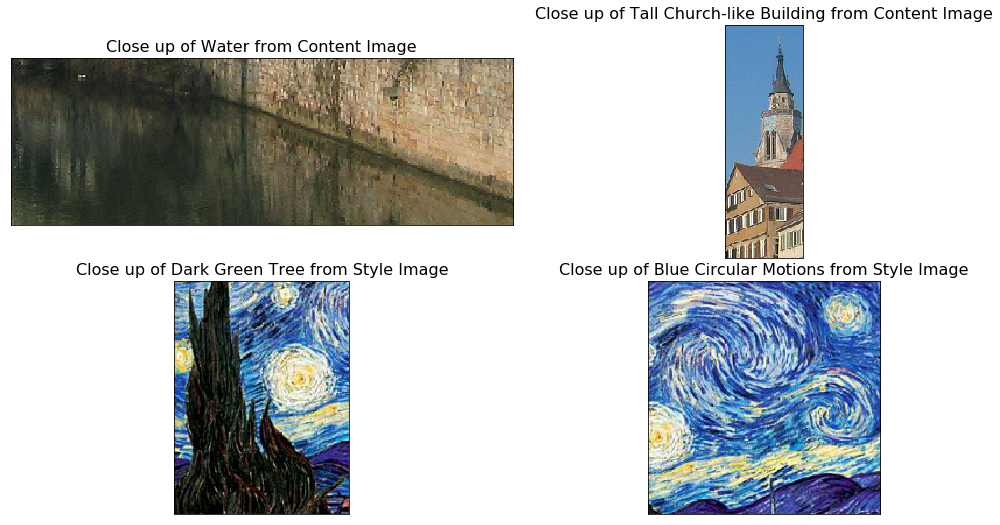

In [103]:
content_visual = Image.open(content_path)
style_visual = Image.open(style_path)

cropped_image1 = content_visual.crop((400, 600, 700, 700))
#cropped_image.save('cropped_image.jpg')
cropped_image2 = content_visual.crop((600, 100, 700, 400))

cropped_image3 = style_visual.crop((50, 100, 200, 300))
cropped_image4 = style_visual.crop((150, 50, 350, 250))

plt.figure(figsize=(18, 9))

plt.subplot(2, 2, 1)
plt.imshow(cropped_image1)
plt.xticks([])
plt.yticks([])
plt.title('Close up of Water from Content Image', fontsize = 16)

plt.subplot(2, 2, 2)
plt.imshow(cropped_image2)
plt.xticks([])
plt.yticks([])
plt.title('Close up of Tall Church-like Building from Content Image', fontsize = 16)

plt.subplot(2, 2, 3)
plt.imshow(cropped_image3)
plt.xticks([])
plt.yticks([])
plt.title('Close up of Dark Green Tree from Style Image', fontsize = 16)

plt.subplot(2, 2, 4)
plt.imshow(cropped_image4)
plt.xticks([])
plt.yticks([])
plt.title('Close up of Blue Circular Motions from Style Image', fontsize = 16)

plt.subplots_adjust(wspace = 0.0, hspace=0.1)
#plt.savefig('explorevisualization.jpg')
plt.show()

Fix image sizes to be the same, in this case choose the smaller larger image to just size down to the same size as the smaller image. The larger image here is the content image.

In [6]:
#Need to create a white noise image, and this function can do it, and can call on this whenever a new white noise image is desired
def get_white_noise_image(width, height):
    pil_map = PIL.Image.new("RGBA", (width, height), 256)
    #use random numbers to generate random colors
    random_grid = map(lambda x: (int(random.random() * 256), int(random.random() * 256), int(random.random() * 256)), [0] * width * height)
    pil_map.putdata(list(random_grid))
    return pil_map


#the following is to test the white noise function, or get a new whitenoise image. Uncomment if needed (usually use the same white noise image for consistency)
#whitenoise = get_white_noise_image(450, 338)
#whitenoise = whitenoise.convert("RGB")
#whitenoise.save('whitenoise.jpg')

#plt.imshow(whitenoise)
#plt.show()

#this function creates the whitenoise image with the same dimensions as the style and content image (450x338), 
#and also pre-processes it as expected for the VGG19 pre-trained network
def process_img(width, height):
    max_dim = 450
    img = get_white_noise_image(width, height)
    long = max(img.size)
    scale = max_dim/long
    img = img.resize((width, height), PIL.Image.ANTIALIAS)
    img = kp_image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.vgg19.preprocess_input(img)
    return img
    

Pre-processing the content and style image as expected for th VGG19 pre-trained network.

In [7]:
def load_and_process_img(image):
    image = load_img(image)
    img = tf.keras.applications.vgg19.preprocess_input(image)
    return img


content = load_and_process_img('Houses.jpg')
style = load_and_process_img('StarryNight.jpg')


The deprocess image function is so we can read the final result as an array or image. Without this, we could not view the final result. Both the process image and deprocess image function were taken from https://github.com/tensorflow/models/blob/master/research/nst_blogpost/4_Neural_Style_Transfer_with_Eager_Execution.ipynb

In [16]:
def deprocess_img(processed_img):
    x = processed_img.copy()
    if len(x.shape) == 4:
        x = np.squeeze(x, 0)
    assert len(x.shape) == 3, ("Input to deprocess image must be an image of "
                             "dimension [1, height, width, channel] or [height, width, channel]")
    if len(x.shape) != 3:
        raise ValueError("Invalid input to deprocessing image")
        
    # perform the inverse of the preprocessiing step
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

The same Content and Style Layers from Gatys' Paper. https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf

In [93]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer we are interested in
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

Getting the loss values for content and style images. Again, these functions come from https://github.com/tensorflow/models/blob/master/research/nst_blogpost/4_Neural_Style_Transfer_with_Eager_Execution.ipynb

In [94]:
#take the difference and square it.
def get_content_loss(base_content, target):
    return tf.reduce_mean(tf.square(base_content - target))

In [95]:
#the gram matrix is a matrix with elements as inner products of vectorized feature maps of the specified layer.
def gram_matrix(input_tensor):
    # We make the image channels first 
    channels = int(input_tensor.shape[-1])
    a = tf.reshape(input_tensor, [-1, channels])
    n = tf.shape(a)[0]
    gram = tf.matmul(a, a, transpose_a=True)
    return gram / tf.cast(n, tf.float32)

def get_style_loss(base_style, gram_target):
    """Expects two images of dimension h, w, c"""
    # height, width, num filters of each layer
    # We scale the loss at a given layer by the size of the feature map and the number of filters
    height, width, channels = base_style.get_shape().as_list()
    gram_style = gram_matrix(base_style)
    
    #once the gram matrices have been obtained, the style loss is again a squared difference
    return tf.reduce_mean(tf.square(gram_style - gram_target))# / (4. * (channels ** 2) * (width * height) ** 2)

The compute_loss function actually computes the total loss and use the previous two functions in tandem. Again, this has been taken from https://github.com/tensorflow/models/blob/master/research/nst_blogpost/4_Neural_Style_Transfer_with_Eager_Execution.ipynb

In [96]:
def compute_loss(model, loss_weights, init_image, gram_style_features, content_features):
    """This function will compute the loss total loss.
    Arguments:
    model: The model that will give us access to the intermediate layers
    loss_weights: The weights of each contribution of each loss function. 
        (style weight, content weight, and total variation weight)
    init_image: Our initial base image. This image is what we are updating with 
      our optimization process. We apply the gradients wrt the loss we are 
      calculating to this image.
    gram_style_features: Precomputed gram matrices corresponding to the 
      defined style layers of interest.
    content_features: Precomputed outputs from defined content layers of 
      interest.
      
    Returns: returns the total loss, style loss, content loss, and total variational loss
  """
    style_weight, content_weight = loss_weights
    
    # Feed our init image through our model. This will give us the content and 
    # style representations at our desired layers. Since we're using eager
    # our model is callable just like any other function!
    model_outputs = model(init_image)
    
    style_output_features = model_outputs[:num_style_layers]
    content_output_features = model_outputs[num_style_layers:]
    
    style_score = 0
    content_score = 0
    
    # Accumulate style losses from all layers
    # Here, we equally weight each contribution of each loss layer
    weight_per_style_layer = 1.0 / float(num_style_layers) #there are 5 style layers, so the weight for each style layer is 1/5, just as in Gatys paper
    for target_style, comb_style in zip(gram_style_features, style_output_features):
        style_score += weight_per_style_layer * get_style_loss(comb_style[0], target_style)
        
    # Accumulate content losses from all layers 
    weight_per_content_layer = 1.0 / float(num_content_layers) #there is only one content layer, so the weight is just one, as in Gatys paper
    for target_content, comb_content in zip(content_features, content_output_features):
        content_score += weight_per_content_layer * get_content_loss(comb_content[0], target_content)
        
    style_score *= style_weight
    content_score *= content_weight
    
    # Get total loss
    loss = style_score + content_score 
    return loss, style_score, content_score

In [97]:
#compute the gradients to apply to iteratively apply to the initial white-noise image. This function is borrowed from https://github.com/tensorflow/models/blob/master/research/nst_blogpost/4_Neural_Style_Transfer_with_Eager_Execution.ipynb
def compute_grads(cfg):
  with tf.GradientTape() as tape: 
    all_loss = compute_loss(**cfg)
  # Compute gradients wrt input image
  total_loss = all_loss[0]
  return tape.gradient(total_loss, cfg['init_image']), all_loss

Now we finally run the program. A lot of this code was taken from https://github.com/tensorflow/models/blob/master/research/nst_blogpost/4_Neural_Style_Transfer_with_Eager_Execution.ipynb,
but it as been significantly modified to fit this project. Some unnecessary calculations were also removed to save time, given that 1000 iterations takes about 5 hours.

143193980.0 0


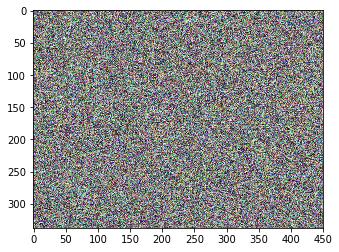

68823690.0 1


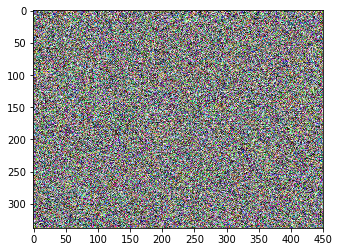

47133996.0 2


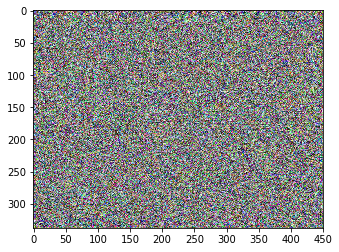

36804116.0 3


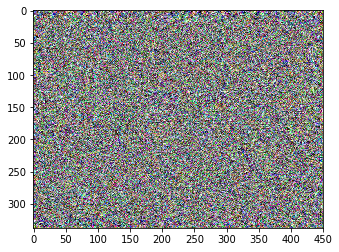

30391296.0 4


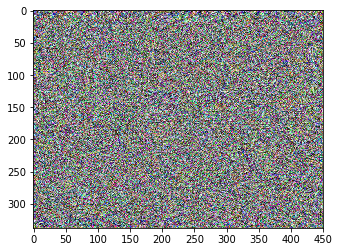

30375892.0 5


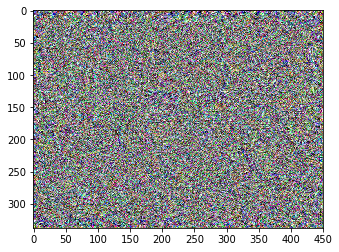

22857954.0 6


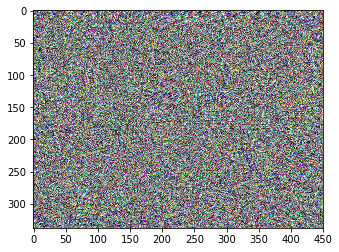

18301916.0 8


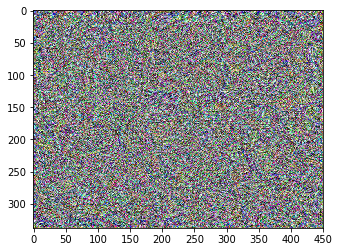

14963072.0 10


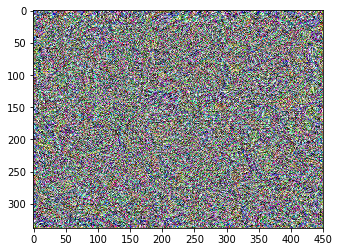

12615618.0 12


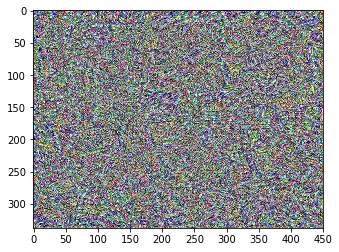

11109021.0 14


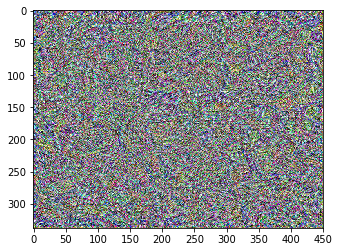

10255430.0 16


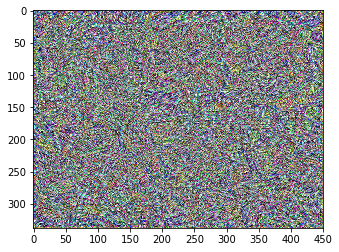

9686256.0 18


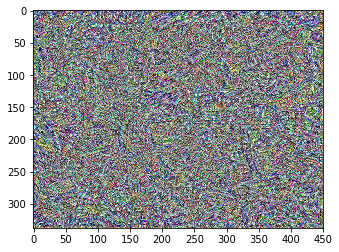

8797980.0 20


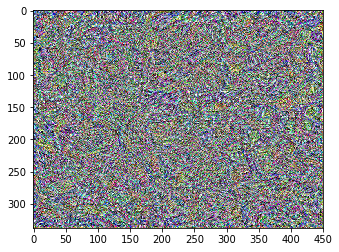

7761027.0 22


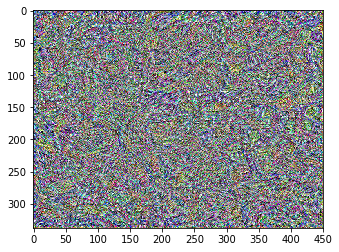

7651231.0 23


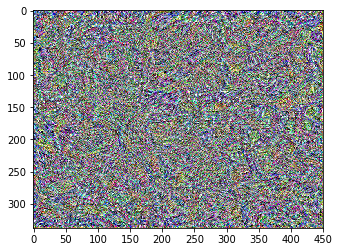

6913485.0 24


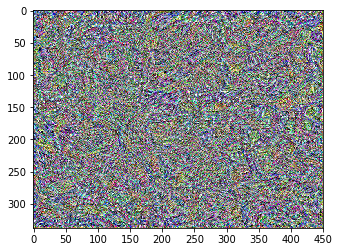

6757241.5 25


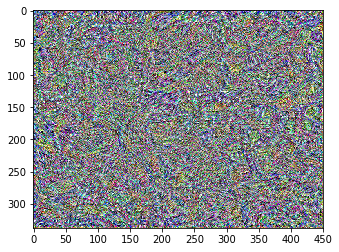

6342318.0 26


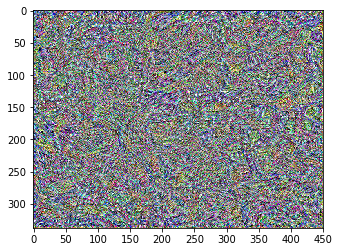

6235619.0 27


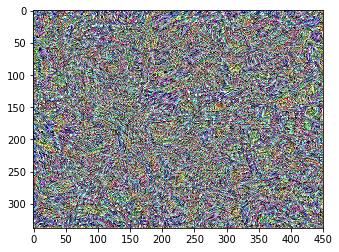

5988406.0 28


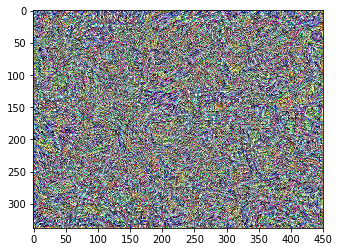

5984493.0 29


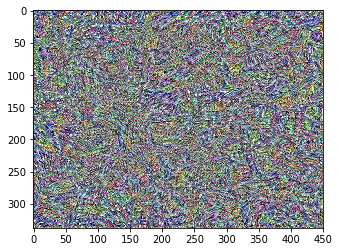

5522865.5 41


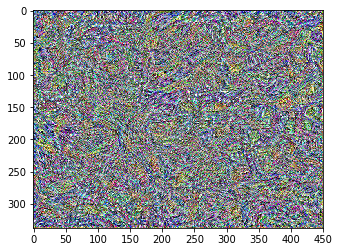

5456887.0 42


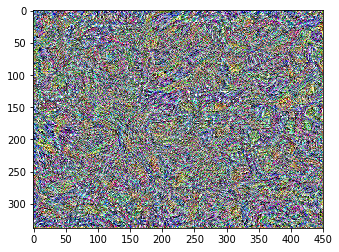

4898860.0 43


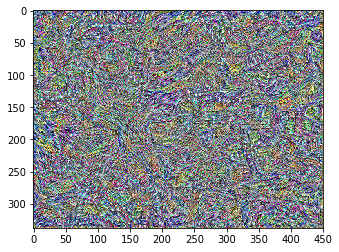

4824120.0 44


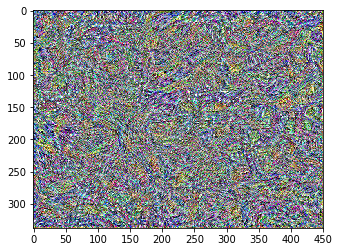

4609860.0 45


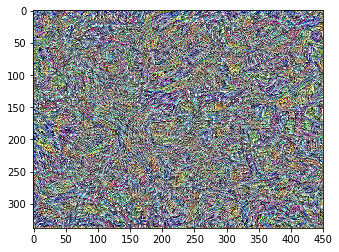

4196278.5 62


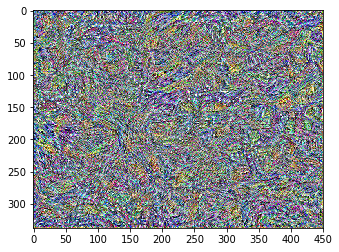

4126878.5 84


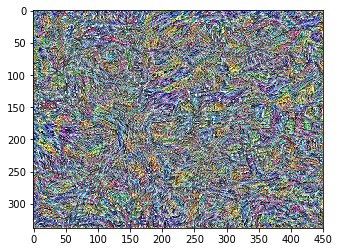

3983127.5 85


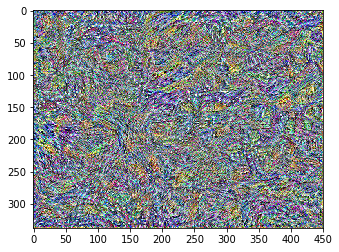

3516101.0 86


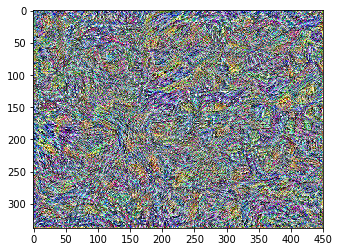

3444171.0 114


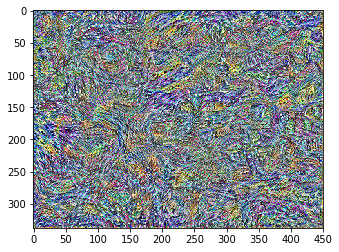

3415249.5 138


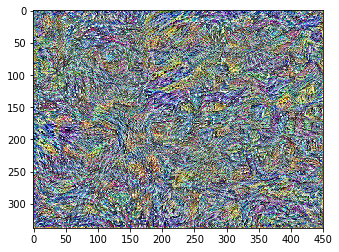

3292400.0 190


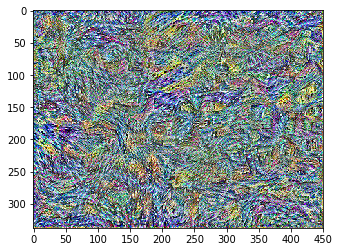

3165018.8 203


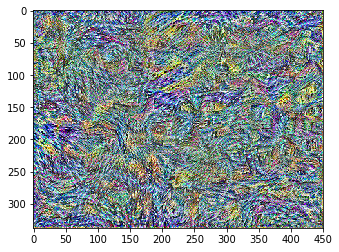

2918268.0 204


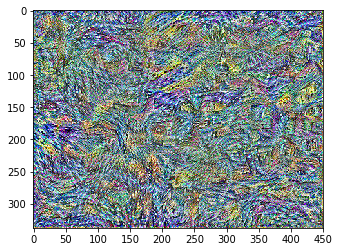

2861294.0 205


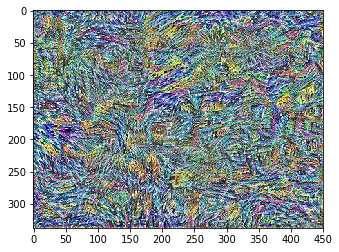

2655259.0 206


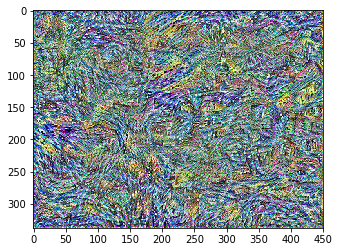

2544104.8 208


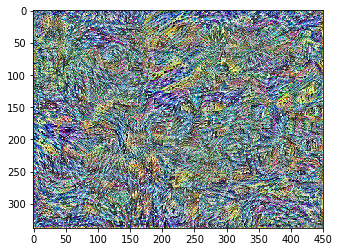

2523247.5 210


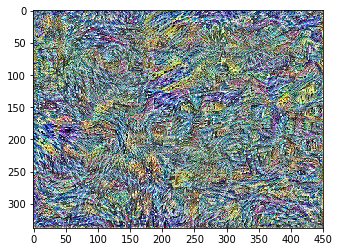

2383452.0 328


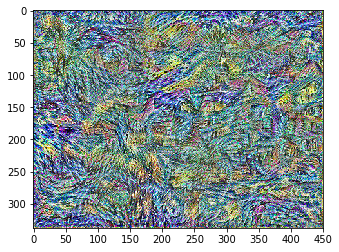

2301948.5 329


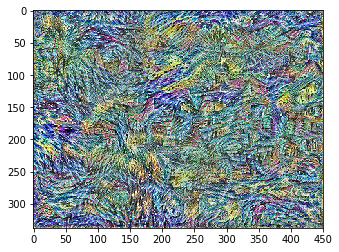

2192891.5 330


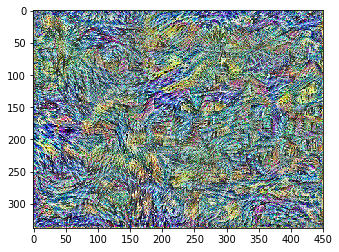

2175358.5 331


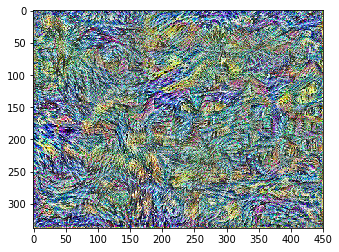

2153368.0 332


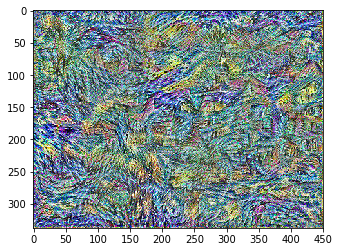

2095410.1 819


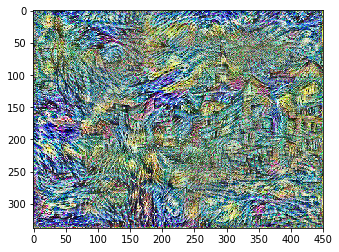

2072734.2 820


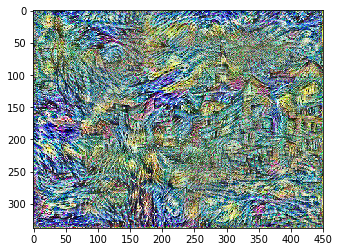

2053650.4 821


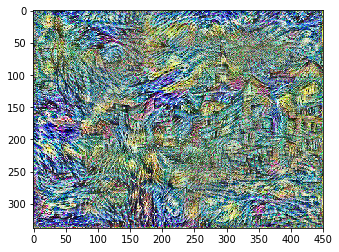

2030247.2 840


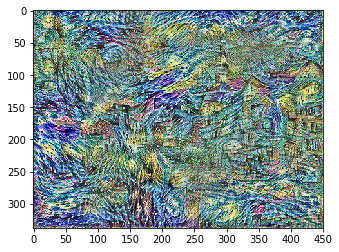

1997460.8 1087


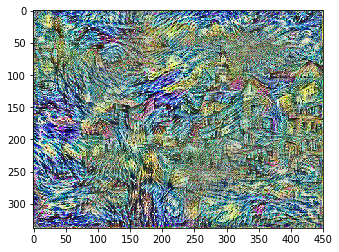

1961454.0 1089


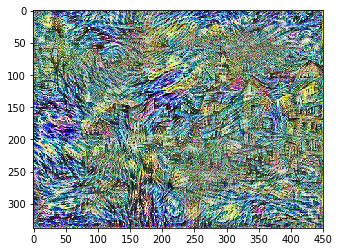

1960395.0 1091


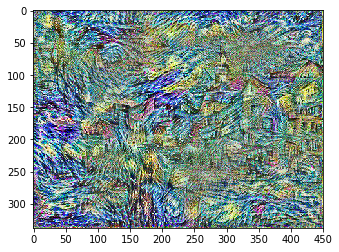

1880371.2 1119


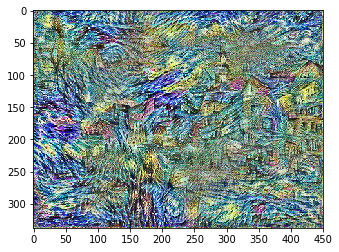

1866451.0 1453


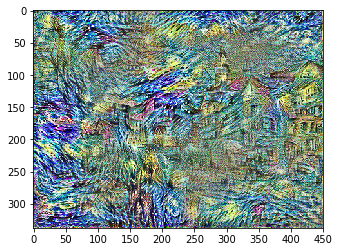

1728639.2 1672


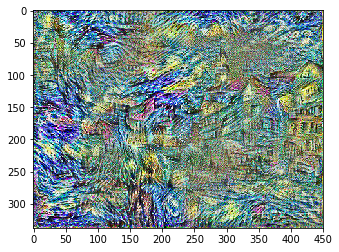

1722809.8 2085


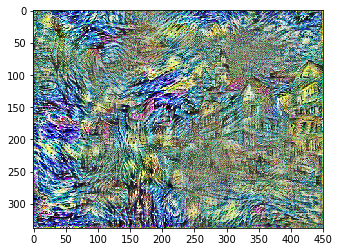

1663123.5 2086


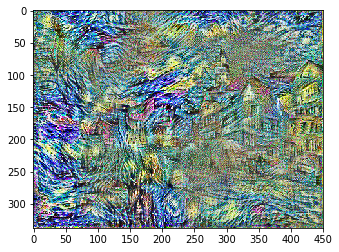

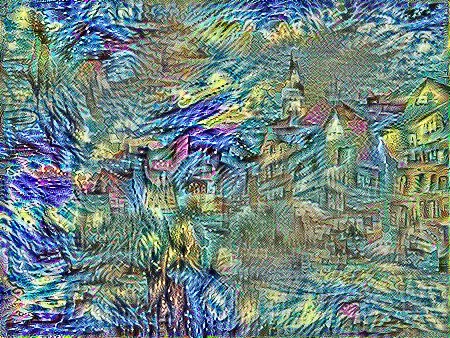

In [33]:
import IPython.display

#define iterations and parameter values
num_iterations = 3000
content_weight = 1e3
style_weight = 1e-3
    
#Load the pre-trained network  
vgg = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet')
vgg.trainable = False

#Get output layers corresponding to style and content layers. 
style_outputs = [vgg.get_layer(name).output for name in style_layers]
content_outputs = [vgg.get_layer(name).output for name in content_layers]
model_outputs = style_outputs + content_outputs
# Build model 
model = models.Model(vgg.input, model_outputs)

#We don't need to (or want to) train any layers of our model, so we set their trainable to false.
for layer in model.layers:
    layer.trainable = False
    
#Getting the content and style images
content_image = load_and_process_img(content_path)
style_image = load_and_process_img(style_path)

# Get the style and content feature representations (from our specified intermediate layers). These are what we need to get the loss  
#batch compute content and style features
style_outputs = model(style_image)
content_outputs = model(content_image)
  
#Get the style and content feature representations from our model  
style_features = [style_layer[0] for style_layer in style_outputs[:num_style_layers]]
content_features = [content_layer[0] for content_layer in content_outputs[num_style_layers:]]

gram_style_features = [gram_matrix(style_feature) for style_feature in style_features]
    
#Set initial image
init_image = load_and_process_img('whitenoise.jpg') 
init_image = tfe.Variable(init_image, dtype=tf.float32)

# Create our optimizer. Commented optimizers are the previously attempted optimizers. Adadelta provided the best result
#opt = tf.train.AdamOptimizer(learning_rate=6, beta1 = 0.9, epsilon = 1e-1) 
#opt = tf.train.GradientDescentOptimizer(learning_rate=1)
opt = tf.train.AdadeltaOptimizer(learning_rate=8, rho = 0.95, epsilon = 1e-1)
#opt = tf.train.MomentumOptimizer(learning_rate=1, momentum = 0.9)

    
# Store our best result. These are the initial starting points (essentially nothing)
best_loss, best_img = float('inf'), None
    
# Create a nice config 
loss_weights = (style_weight, content_weight)
cfg = {'model': model, 'loss_weights': loss_weights, 'init_image': init_image, 'gram_style_features': gram_style_features, 'content_features': content_features}
    
#this is since pixel color values dont exceed 256
norm_means = np.array([103.939, 116.779, 123.68])
min_vals = -norm_means
max_vals = 255 - norm_means   
imgs = []


losslst = []
images = [] 

for i in range(num_iterations):
    #get the loss function and apply the gradients to the white-noise image
    grads, all_loss = compute_grads(cfg)
    loss, style_score, content_score = all_loss
    opt.apply_gradients([(grads, init_image)])
    clipped = tf.clip_by_value(init_image, min_vals, max_vals)
    init_image.assign(clipped)
    end_time = time.time() 
    
    if loss < best_loss:
        # Update best loss and best image from total loss. 
        best_loss = loss
        best_img = deprocess_img(init_image.numpy())
        
        #printing and showing the best intermediate steps to see how well it is going
        print(best_loss.numpy(), i)
        im = Image.fromarray(best_img)
        plt.imshow(im)
        plt.show()
        
        #saving the best values for later analysis if needed
        losslst.append(best_loss.numpy())
        images.append(best_img)
        
        
        
Image.fromarray(best_img)

In [65]:
#Solution = Image.fromarray(best_img)
#Solution.save('solution5.jpg')

Creating a visualiztion image for the paper, showing some intermediate images throughout the process, and how it changes side by side.

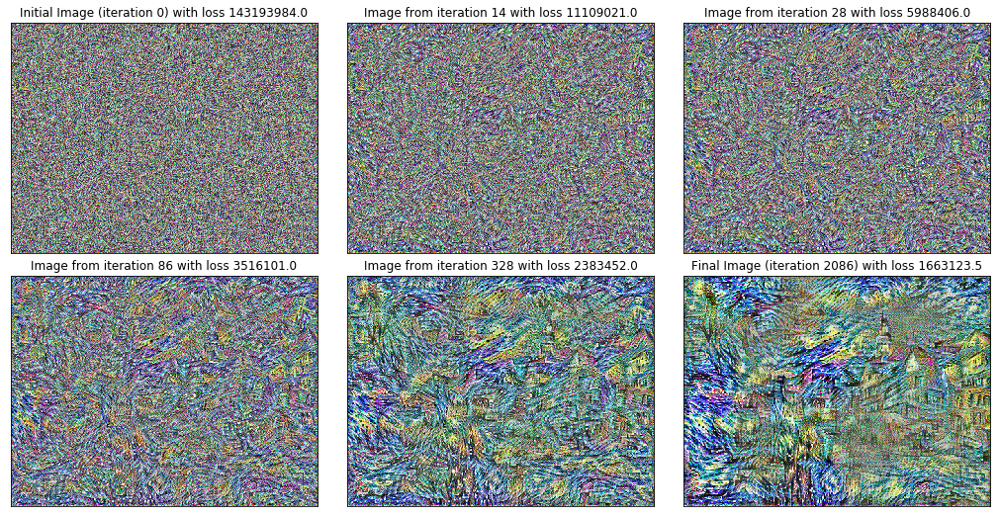

In [86]:
image1=Image.fromarray(images[0])
image2=Image.fromarray(images[10])
image3=Image.fromarray(images[20])
image4=Image.fromarray(images[30])
image5=Image.fromarray(images[40])
image6=Image.fromarray(images[56])


plt.figure(figsize=(18, 9))

plt.subplot(2, 3, 1)
plt.imshow(image1)
plt.xticks([])
plt.yticks([])
plt.title('Initial Image (iteration 0) with loss {}'.format(losslst[0]))

plt.subplot(2, 3, 2)
plt.imshow(image2)
plt.xticks([])
plt.yticks([])
plt.title('Image from iteration 14 with loss {}'.format(losslst[10]))

plt.subplot(2, 3, 3)
plt.imshow(image3)
plt.xticks([])
plt.yticks([])
plt.title('Image from iteration 28 with loss {}'.format(losslst[20]))

plt.subplot(2, 3, 4)
plt.imshow(image4)
plt.xticks([])
plt.yticks([])
plt.title('Image from iteration 86 with loss {}'.format(losslst[30]))

plt.subplot(2, 3, 5)
plt.imshow(image5)
plt.xticks([])
plt.yticks([])
plt.title('Image from iteration 328 with loss {}'.format(losslst[40]))

plt.subplot(2, 3, 6)
plt.imshow(image6)
plt.xticks([])
plt.yticks([])
plt.title('Final Image (iteration 2086) with loss {}'.format(losslst[56]))

plt.subplots_adjust(wspace = 0.05, hspace=0.1)
#plt.savefig('visualization.jpg')
plt.show()


Displaying the content and style images next to the final result for clear comparison.

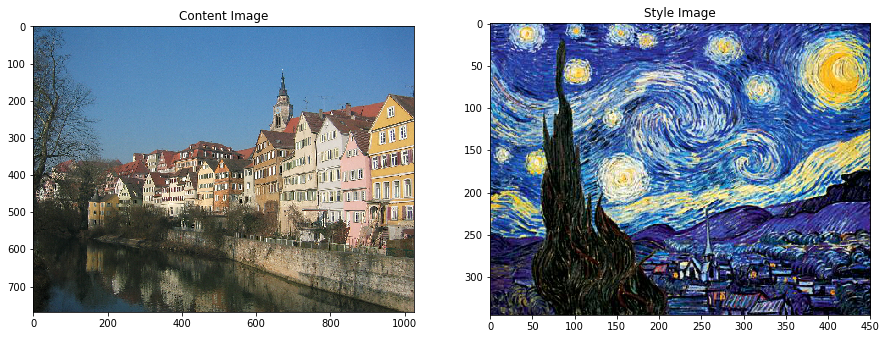

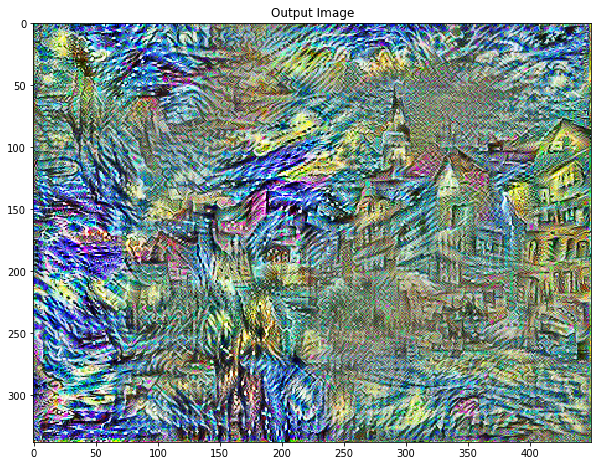

In [45]:
content = PIL.Image.open('Houses.jpg')
style = PIL.Image.open('StarryNight.jpg')

plt.figure(figsize=(15, 15))

plt.subplot(1, 2, 1)
plt.imshow(content)
plt.title('Content Image')

plt.subplot(1, 2, 2)
plt.imshow(style)
plt.title('Style Image')

plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(Solution)
plt.title('Output Image')
plt.show()